In [1]:
import numpy as np
import PIL
import umap
import pandas as pd
import json
import glob
from pytorch_metric_learning import distances, losses, miners, reducers
import torch.nn as nn
import os
import matplotlib.pyplot as plt
import torch
import torchvision
from torchvision import models
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
from torch.utils.data.sampler import SubsetRandomSampler
from tqdm import tqdm
from pytorch_metric_learning import losses, testers
from pytorch_metric_learning.utils.accuracy_calculator import AccuracyCalculator
from pytorch_metric_learning.distances import LpDistance,CosineSimilarity
from pytorch_metric_learning.utils.inference import CustomKNN
%matplotlib inline
import torch
import torch.nn as nn
from matplotlib import pyplot as plt
import numpy as np
import torchvision
import torchvision.datasets as datasets
import torchvision.models as models
from torchvision import transforms
import torch.optim as optim
import time
import tqdm as tqdm
from torch.autograd import Variable

In [2]:
config = {
    'name':'cub_triplet_loss_epshn_resnet50_sgd_aug',
    'dataset':'CUB_200_2011',
    'random_seed':42,
    'model_architecture':'resnet50',
    'embedding_dim':128,
    'distance':'cosine',
    'image_height':224,
    'image_width':224,
    'train_test_split':0.2,
    'class_split':0.1,
    'batch_size':128,
    'optimizer':'sgd',
    'learning_rate':0.001,
    'num_epochs':100,
    'loss':'NTXentLoss',
    'miner':'epshn',
    'reducer':0,
    'metric':'precision_at_1',
    'model_save_path':'models/cub_triplet_loss_epshn_resnet50_sgd_aug',
    'temperature': 0.1
}

In [3]:
np.random.seed(config['random_seed'])
torch.manual_seed(config['random_seed'])
torch.cuda.manual_seed(config['random_seed'])
torch.backends.cudnn.deterministic = False

In [4]:
# print(models.resnet18())
class ResNetFeatrueExtractor50(nn.Module):
    def __init__(self, pretrained = True):
        super(ResNetFeatrueExtractor50, self).__init__()
        self.model = models.resnet50(pretrained=pretrained)
        self.model.fc = nn.Linear(2048, config['embedding_dim'])

    def forward(self, x):
        x = self.model(x)
        return F.normalize(x)

In [5]:
### MNIST code originally from https://github.com/pytorch/examples/blob/master/mnist/main.py ###
def train(model, loss_func,mining_func, device, train_loader, optimizer, epoch):
    model.train()
    train_losses = []
    for batch_idx, (data, labels) in enumerate(train_loader):
        data, labels = data.to(device), labels.to(device)
        optimizer.zero_grad()
        embeddings = model(data)
        indices_tuple = mining_func(embeddings, labels)
        loss = loss_func(embeddings, labels, indices_tuple)
        loss.backward()
        optimizer.step()
        train_losses.append(loss)
        if batch_idx % 100 == 0:
            print("Epoch {} Iteration {}: Loss = {}".format(epoch, batch_idx, loss))
    return torch.mean(torch.tensor(train_losses)).item()
    
### convenient function from pytorch-metric-learning ###
def get_all_embeddings(dataset, model):
    tester = testers.BaseTester(dataloader_num_workers=0)
    return tester.get_all_embeddings(dataset, model)

### compute accuracy using AccuracyCalculator from pytorch-metric-learning ###
def test(train_set, test_set, model, accuracy_calculator):
    train_embeddings, train_labels = get_all_embeddings(train_set, model)
    test_embeddings, test_labels = get_all_embeddings(test_set, model)
    train_labels = train_labels.squeeze(1)
    test_labels = test_labels.squeeze(1)
    print("Computing accuracy")
    accuracies = accuracy_calculator.get_accuracy(
        test_embeddings, test_labels, train_embeddings, train_labels, False
    )
    print("Test set accuracy (Precision@1) = {}".format(accuracies["precision_at_1"]))
    return accuracies["precision_at_1"]
    
device = torch.device("cuda")

mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

# create train and test transforms
transform = transforms.Compose(
    [
        transforms.Resize((config['image_height'], config['image_width'])),
        transforms.ToTensor(),
        transforms.Normalize(mean, std),
    ]
)

batch_size = 128

In [6]:
def tra_transforms(imgsize, RGBmean, RGBstdv):
    return transforms.Compose([transforms.Resize(int(imgsize*1.1)),
                                 transforms.RandomCrop(imgsize),
                                 transforms.RandomHorizontalFlip(),
                                 transforms.ToTensor(),
                                 transforms.Normalize(RGBmean, RGBstdv)])

def eva_transforms(imgsize, RGBmean, RGBstdv):
    return transforms.Compose([transforms.Resize(imgsize),
                                 transforms.CenterCrop(imgsize),
                                 transforms.ToTensor(),
                                 transforms.Normalize(RGBmean, RGBstdv)])

In [7]:
train_transform = tra_transforms(224,mean,std)
test_transform = eva_transforms(224,mean,std)

In [8]:
with open('CUB_200_2011/classes.txt','r') as f:
    classes = f.readlines()
classes = [i.replace('\n','') for i in classes]
classes = [i.split(' ')[1] for i in classes]
class_dict = {k:v for k,v in zip(classes,range(200))}

In [9]:
image_paths = []
labels = []
for folder_path,i in class_dict.items():
    folder_images = glob.glob('CUB_200_2011/images/'+'/'+str(folder_path)+'/*')
    image_paths.extend(folder_images)
    labels.extend([i]*len(folder_images))

In [10]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(image_paths, labels, test_size=config['train_test_split'],
                                                    stratify=labels,
                                                    random_state=config['random_seed'])

In [11]:
print(len(X_train), len(X_test), len(y_train), len(y_test))

9430 2358 9430 2358


In [12]:
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms

class CUBDataset(Dataset):
    def __init__(self, image_paths,labels,transform=None):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform
        self.load_image_from_paths()
        
    def load_image_from_paths(self):
        self.images = []
        for i in self.image_paths:
            img = PIL.Image.open(i)
            if len(img.getbands()) ==1 :
                img = img.convert("RGB")
            self.images.append(img)
            
    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image = self.images[idx]
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)
        return image, label

In [13]:
train_dataset  = CUBDataset(X_train,y_train,train_transform)
test_dataset  = CUBDataset(X_test,y_test,test_transform)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=128, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=128, shuffle=False)

In [15]:
model = torch.load('models/cub_triplet_loss_epshn_resnet50_sgd_aug_180.pth',map_location='cuda')

In [16]:
model.eval()

ResNetFeatrueExtractor50(
  (model): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequent

In [17]:
train_embeddings, train_labels = get_all_embeddings(train_dataset, model)
test_embeddings, test_labels = get_all_embeddings(test_dataset, model)
train_labels = train_labels.squeeze(1)
test_labels = test_labels.squeeze(1)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:07<00:00,  9.72it/s]


In [18]:
import faiss
# Create a Faiss index
index = faiss.IndexFlatIP(128)
# Add some vectors to the index
index.add(train_embeddings.detach().cpu().numpy())

In [19]:
def extract_category(path):
    return path.split('/')[-2]
sorted_paths = sorted(X_test, key=extract_category)

In [20]:
rev_class_dict = {v:k for k,v in class_dict.items()}

true label: 001.Black_footed_Albatross  | predicted label: 003.Sooty_Albatross [3, 3, 23, 1, 3, 5, 1, 61, 134, 45]


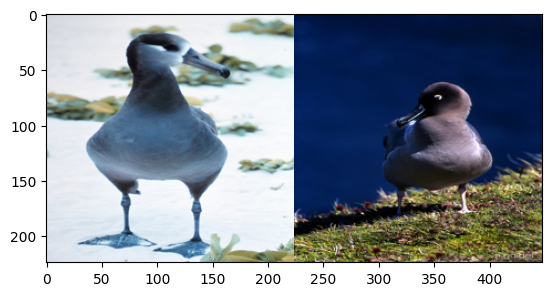

true label: 001.Black_footed_Albatross  | predicted label: 003.Sooty_Albatross [3, 3, 3, 1, 3, 1, 1, 3, 3, 1]


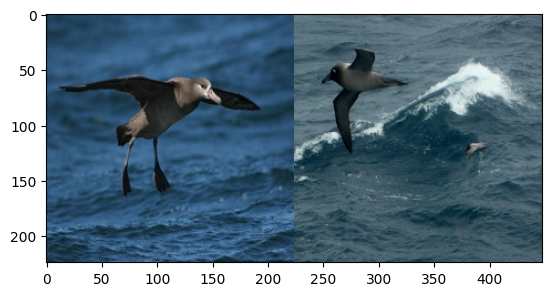

true label: 002.Laysan_Albatross  | predicted label: 084.Red_legged_Kittiwake [84, 63, 84, 84, 45, 63, 84, 84, 45, 84]


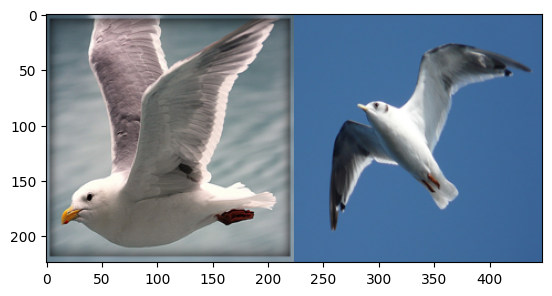

true label: 003.Sooty_Albatross  | predicted label: 001.Black_footed_Albatross [1, 1, 1, 3, 1, 1, 1, 1, 1, 1]


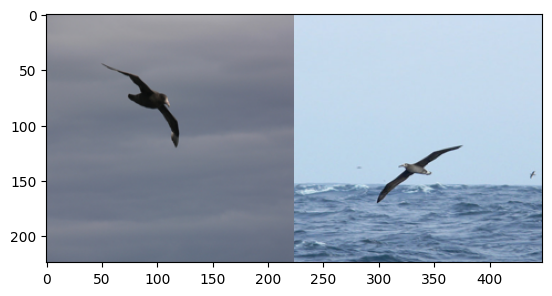

true label: 003.Sooty_Albatross  | predicted label: 045.Northern_Fulmar [45, 3, 3, 3, 3, 5, 3, 3, 1, 3]


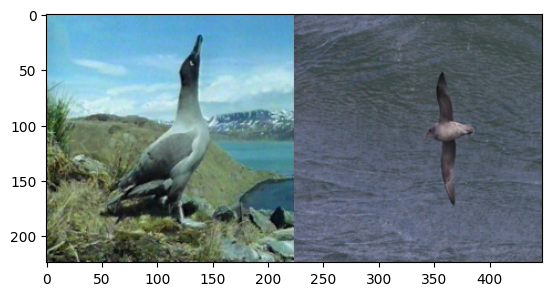

true label: 004.Groove_billed_Ani  | predicted label: 027.Shiny_Cowbird [27, 4, 4, 4, 30, 4, 4, 30, 4, 30]


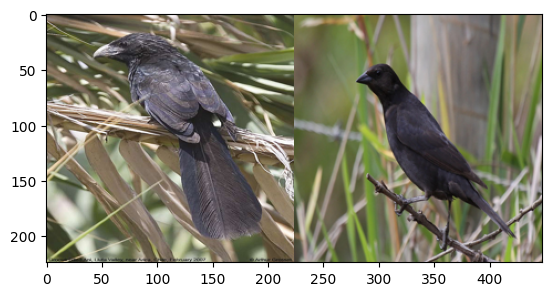

true label: 005.Crested_Auklet  | predicted label: 024.Red_faced_Cormorant [24, 24, 5, 24, 5, 5, 5, 5, 24, 5]


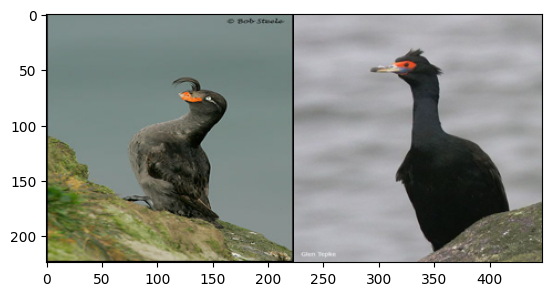

true label: 005.Crested_Auklet  | predicted label: 007.Parakeet_Auklet [7, 7, 5, 58, 7, 58, 5, 7, 58, 7]


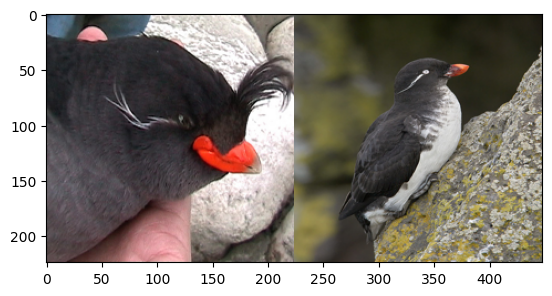

true label: 006.Least_Auklet  | predicted label: 190.Red_cockaded_Woodpecker [190, 6, 6, 6, 6, 6, 6, 6, 6, 6]


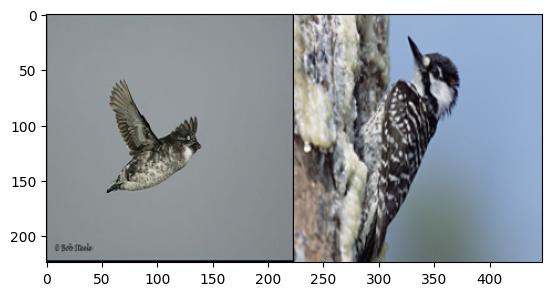

true label: 008.Rhinoceros_Auklet  | predicted label: 058.Pigeon_Guillemot [58, 23, 23, 23, 8, 8, 25, 25, 44, 8]


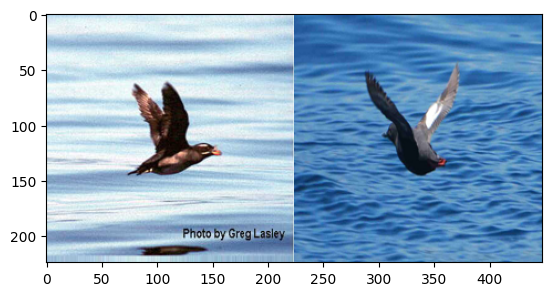

true label: 008.Rhinoceros_Auklet  | predicted label: 058.Pigeon_Guillemot [58, 5, 8, 5, 5, 58, 58, 5, 45, 5]


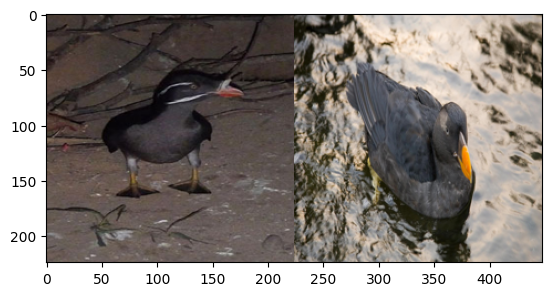

true label: 009.Brewer_Blackbird  | predicted label: 027.Shiny_Cowbird [27, 9, 49, 9, 11, 49, 49, 27, 9, 9]


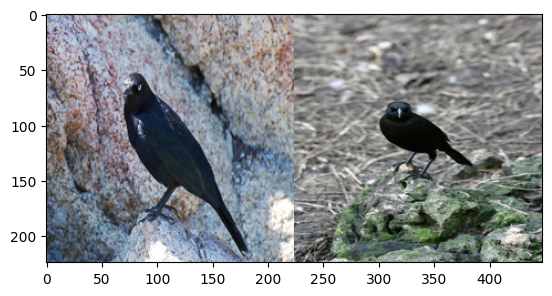

true label: 009.Brewer_Blackbird  | predicted label: 049.Boat_tailed_Grackle [49, 30, 11, 27, 27, 27, 49, 27, 27, 49]


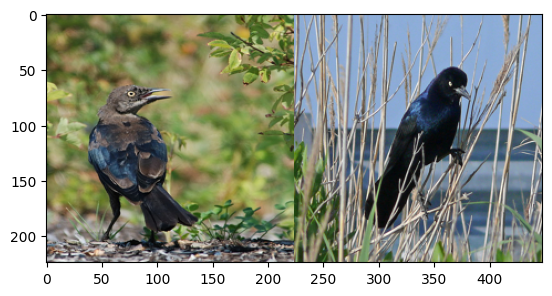

true label: 009.Brewer_Blackbird  | predicted label: 027.Shiny_Cowbird [27, 27, 9, 49, 9, 30, 49, 27, 29, 9]


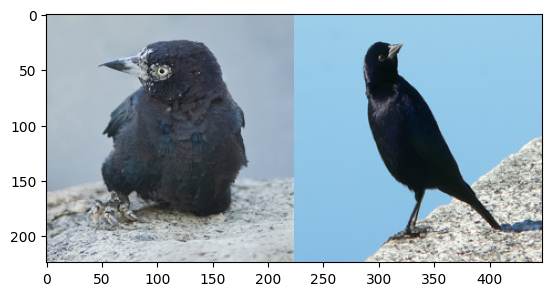

true label: 009.Brewer_Blackbird  | predicted label: 004.Groove_billed_Ani [4, 4, 26, 4, 9, 4, 11, 26, 4, 27]


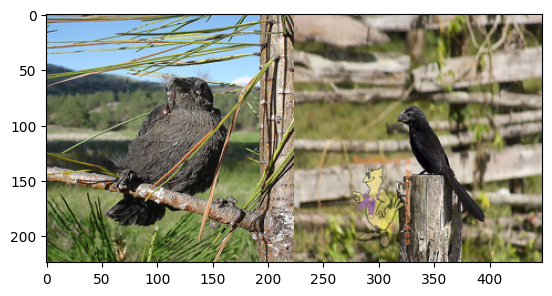

true label: 009.Brewer_Blackbird  | predicted label: 027.Shiny_Cowbird [27, 9, 11, 29, 29, 27, 29, 9, 9, 29]


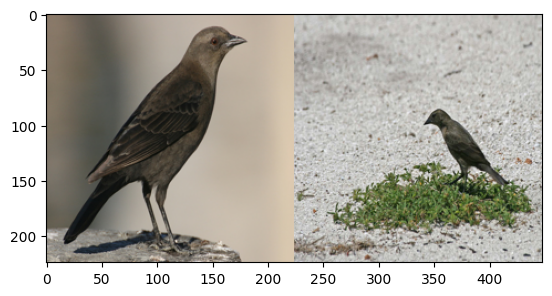

true label: 010.Red_winged_Blackbird  | predicted label: 004.Groove_billed_Ani [4, 4, 10, 4, 4, 10, 4, 4, 30, 29]


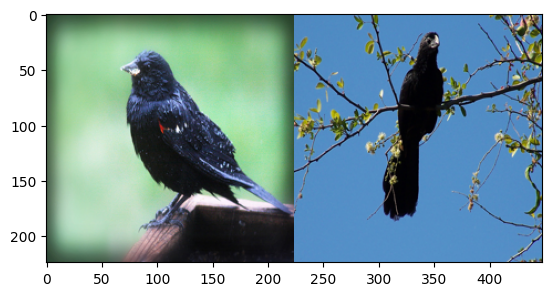

true label: 011.Rusty_Blackbird  | predicted label: 010.Red_winged_Blackbird [10, 26, 26, 26, 11, 11, 11, 11, 11, 26]


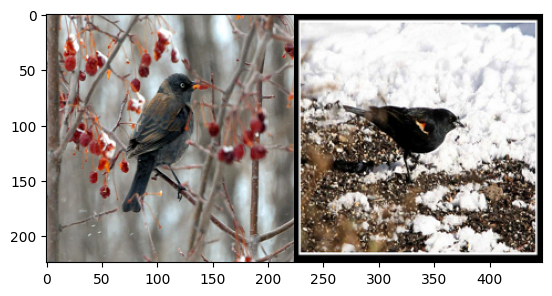

true label: 011.Rusty_Blackbird  | predicted label: 134.Cape_Glossy_Starling [134, 134, 134, 49, 134, 134, 134, 134, 49, 9]


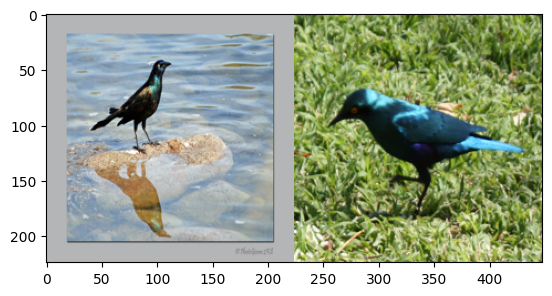

true label: 011.Rusty_Blackbird  | predicted label: 027.Shiny_Cowbird [27, 30, 27, 49, 9, 29, 9, 30, 9, 9]


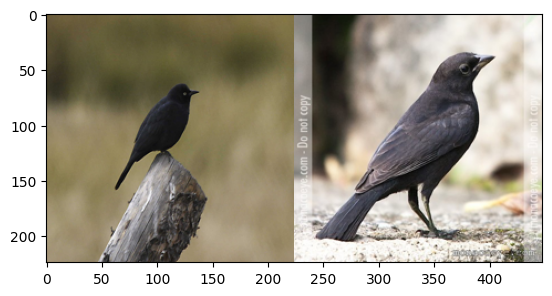

true label: 011.Rusty_Blackbird  | predicted label: 003.Sooty_Albatross [3, 3, 11, 9, 1, 170, 84, 3, 3, 3]


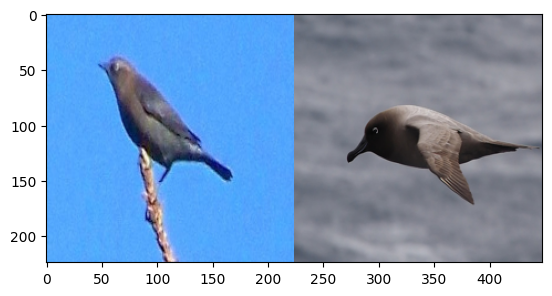

true label: 011.Rusty_Blackbird  | predicted label: 009.Brewer_Blackbird [9, 11, 9, 9, 9, 11, 27, 11, 11, 11]


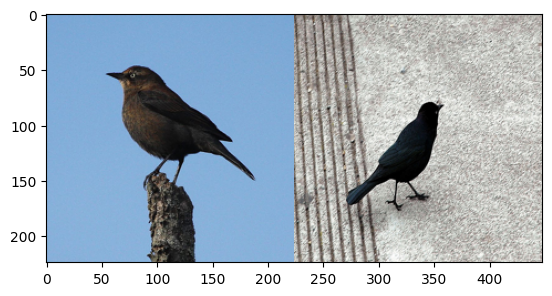

true label: 011.Rusty_Blackbird  | predicted label: 027.Shiny_Cowbird [27, 128, 128, 54, 29, 11, 11, 128, 128, 11]


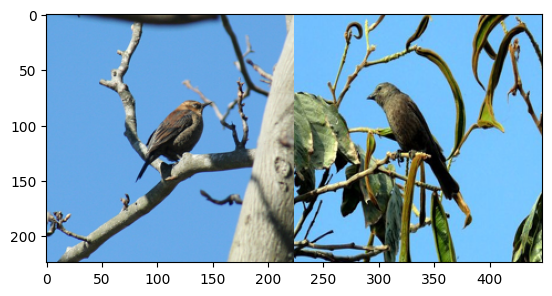

true label: 013.Bobolink  | predicted label: 027.Shiny_Cowbird [27, 9, 27, 49, 27, 27, 27, 27, 9, 27]


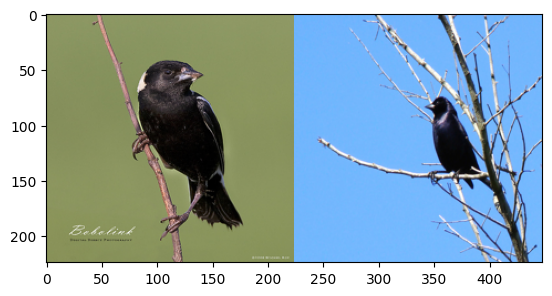

true label: 013.Bobolink  | predicted label: 197.Marsh_Wren [197, 126, 136, 137, 135, 136, 137, 126, 137, 137]


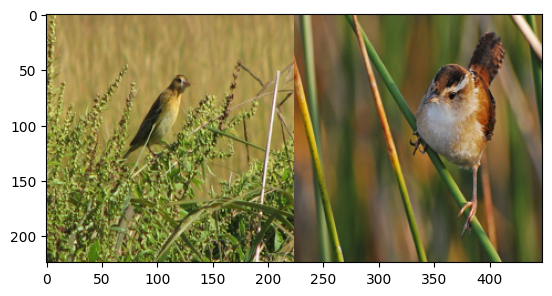

true label: 014.Indigo_Bunting  | predicted label: 021.Eastern_Towhee [21, 21, 21, 21, 21, 21, 21, 21, 21, 21]


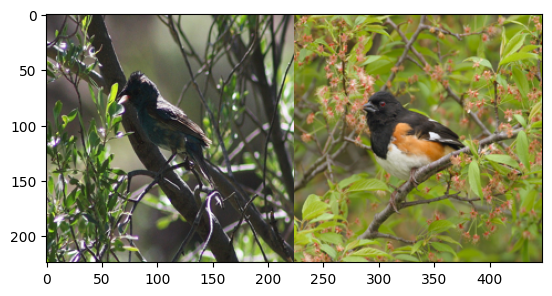

true label: 014.Indigo_Bunting  | predicted label: 054.Blue_Grosbeak [54, 54, 14, 14, 54, 14, 14, 54, 54, 54]


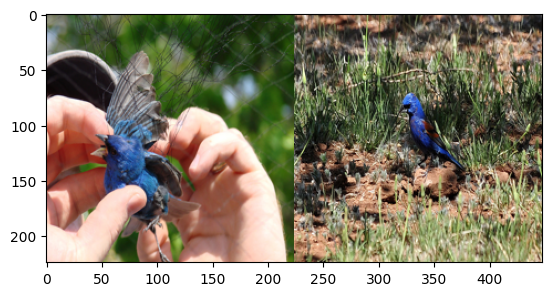

true label: 015.Lazuli_Bunting  | predicted label: 014.Indigo_Bunting [14, 14, 14, 14, 14, 14, 14, 14, 14, 14]


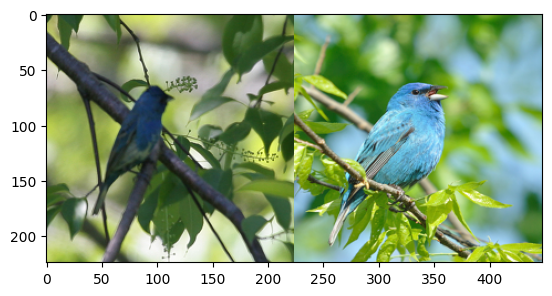

true label: 015.Lazuli_Bunting  | predicted label: 014.Indigo_Bunting [14, 54, 14, 14, 14, 14, 14, 14, 14, 54]


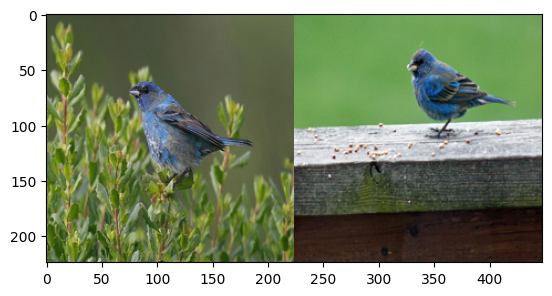

true label: 016.Painted_Bunting  | predicted label: 172.Nashville_Warbler [172, 153, 175, 157, 179, 157, 182, 157, 172, 172]


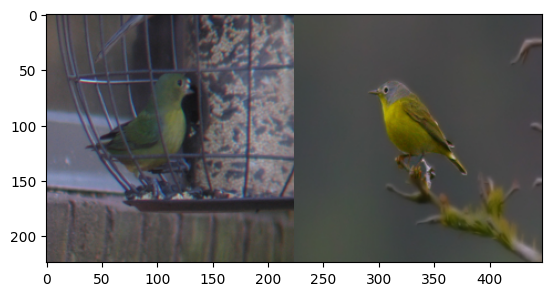

true label: 016.Painted_Bunting  | predicted label: 152.Blue_headed_Vireo [152, 38, 43, 173, 152, 77, 152, 43, 153, 155]


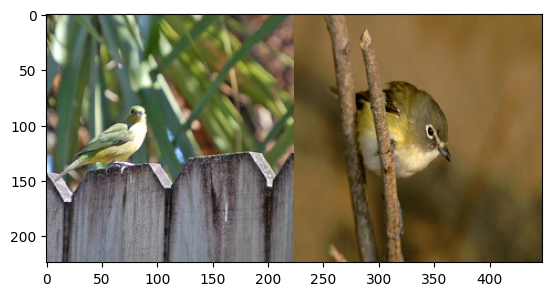

true label: 017.Cardinal  | predicted label: 140.Summer_Tanager [140, 17, 17, 17, 56, 17, 17, 17, 199, 17]


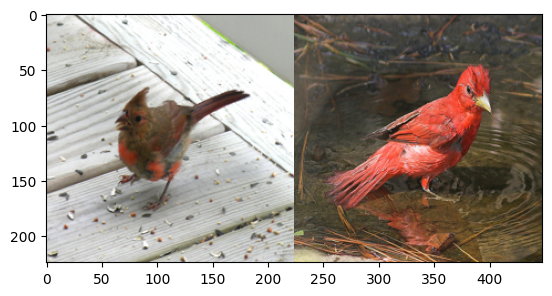

true label: 019.Gray_Catbird  | predicted label: 009.Brewer_Blackbird [9, 27, 19, 19, 19, 19, 19, 29, 19, 19]


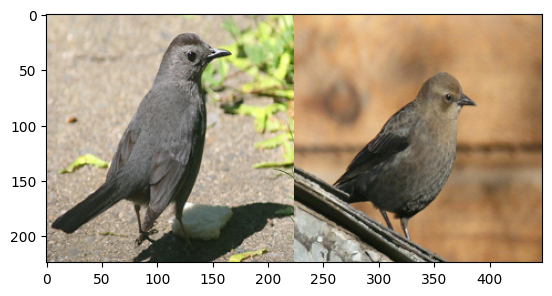

true label: 019.Gray_Catbird  | predicted label: 027.Shiny_Cowbird [27, 11, 38, 128, 19, 19, 27, 19, 19, 102]


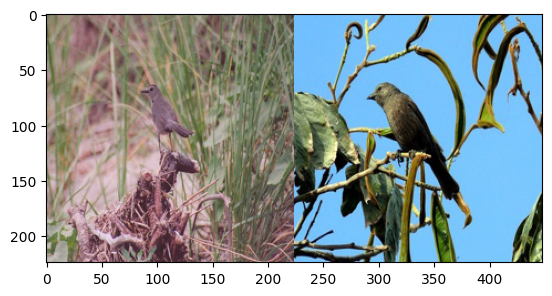

true label: 020.Yellow_breasted_Chat  | predicted label: 200.Common_Yellowthroat [200, 20, 20, 20, 20, 20, 20, 20, 20, 20]


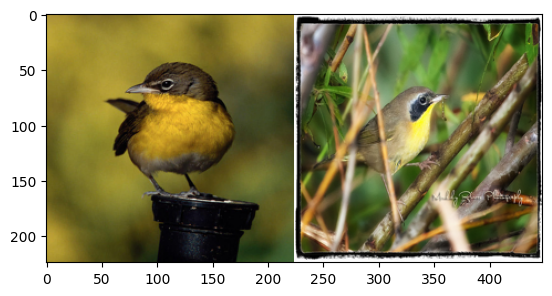

true label: 020.Yellow_breasted_Chat  | predicted label: 157.Yellow_throated_Vireo [157, 20, 161, 20, 161, 161, 20, 161, 177, 177]


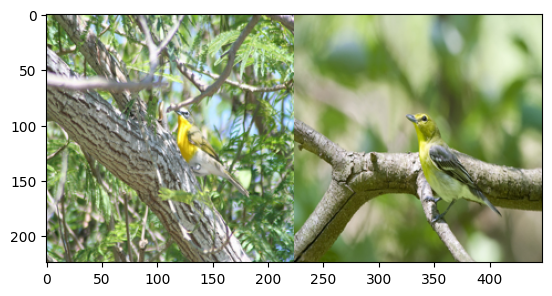

true label: 021.Eastern_Towhee  | predicted label: 097.Orchard_Oriole [97, 34, 21, 199, 195, 149, 11, 34, 21, 97]


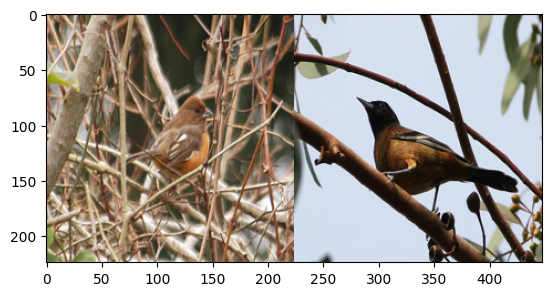

true label: 021.Eastern_Towhee  | predicted label: 109.American_Redstart [109, 21, 21, 21, 21, 21, 21, 21, 21, 21]


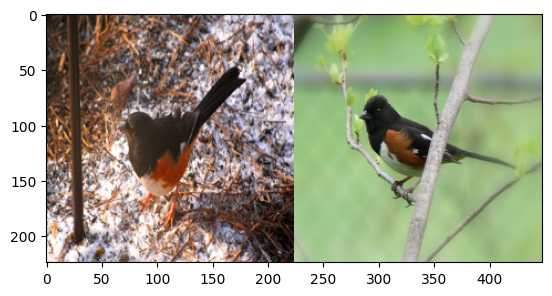

true label: 021.Eastern_Towhee  | predicted label: 097.Orchard_Oriole [97, 80, 80, 97, 82, 97, 97, 97, 97, 80]


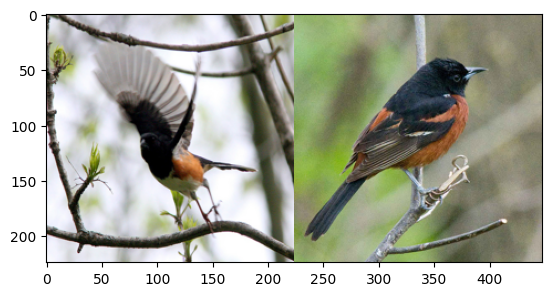

true label: 022.Chuck_will_Widow  | predicted label: 105.Whip_poor_Will [105, 22, 105, 22, 22, 22, 22, 105, 22, 22]


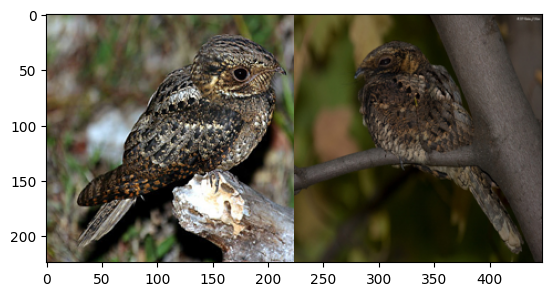

true label: 023.Brandt_Cormorant  | predicted label: 025.Pelagic_Cormorant [25, 25, 25, 23, 23, 23, 25, 25, 23, 23]


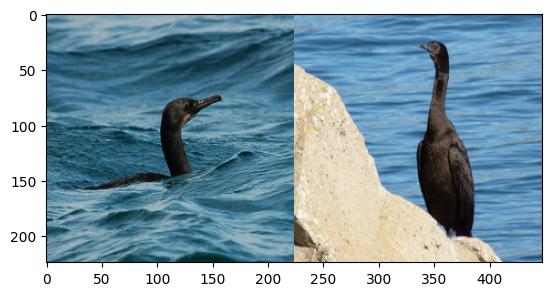

true label: 023.Brandt_Cormorant  | predicted label: 025.Pelagic_Cormorant [25, 23, 23, 23, 23, 23, 23, 23, 23, 25]


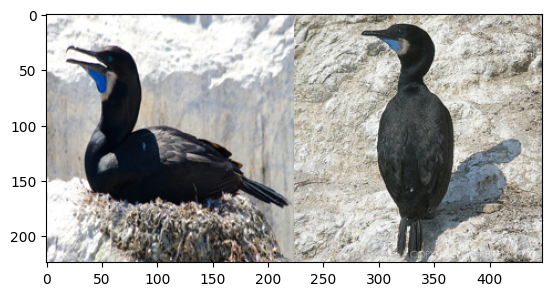

true label: 023.Brandt_Cormorant  | predicted label: 025.Pelagic_Cormorant [25, 23, 23, 25, 23, 25, 23, 23, 25, 25]


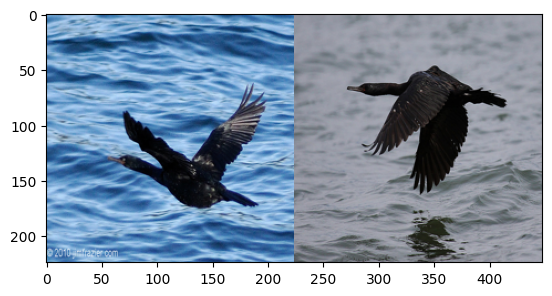

true label: 023.Brandt_Cormorant  | predicted label: 025.Pelagic_Cormorant [25, 23, 25, 23, 23, 44, 23, 23, 23, 23]


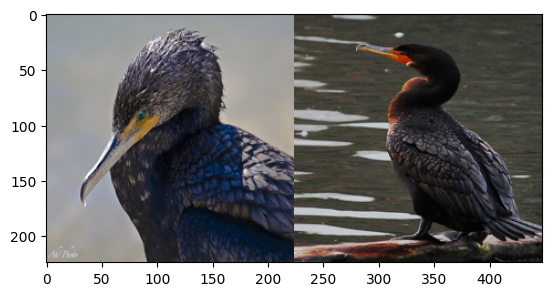

true label: 023.Brandt_Cormorant  | predicted label: 025.Pelagic_Cormorant [25, 25, 52, 52, 23, 23, 25, 86, 25, 52]


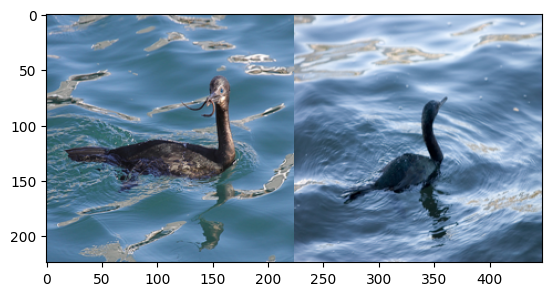

true label: 023.Brandt_Cormorant  | predicted label: 025.Pelagic_Cormorant [25, 25, 25, 23, 23, 23, 23, 23, 25, 25]


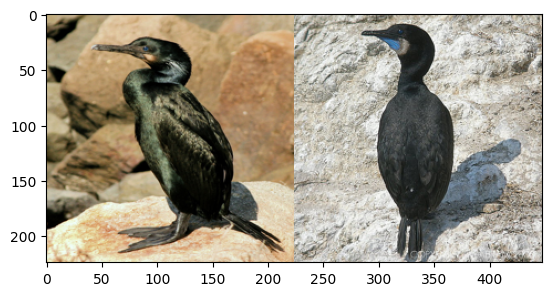

true label: 024.Red_faced_Cormorant  | predicted label: 050.Eared_Grebe [50, 51, 50, 50, 24, 50, 50, 50, 50, 50]


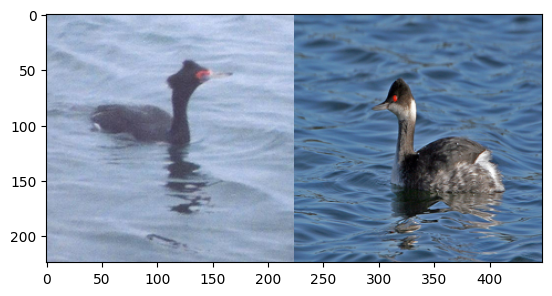

true label: 025.Pelagic_Cormorant  | predicted label: 023.Brandt_Cormorant [23, 23, 25, 8, 23, 23, 23, 23, 1, 8]


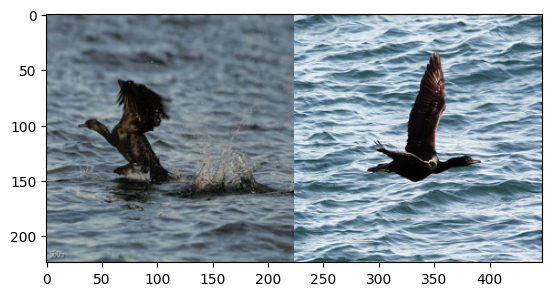

true label: 025.Pelagic_Cormorant  | predicted label: 023.Brandt_Cormorant [23, 25, 23, 25, 23, 23, 25, 25, 23, 25]


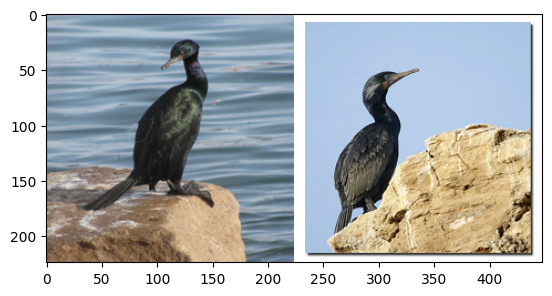

true label: 025.Pelagic_Cormorant  | predicted label: 023.Brandt_Cormorant [23, 23, 23, 25, 25, 23, 23, 23, 23, 25]


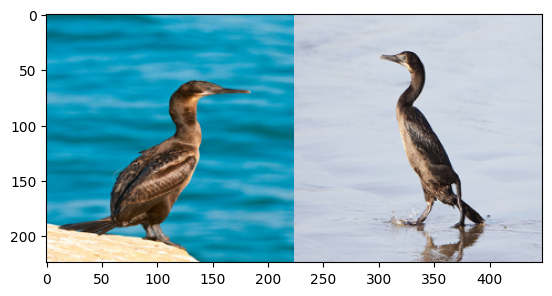

true label: 025.Pelagic_Cormorant  | predicted label: 024.Red_faced_Cormorant [24, 24, 25, 24, 24, 25, 25, 25, 24, 24]


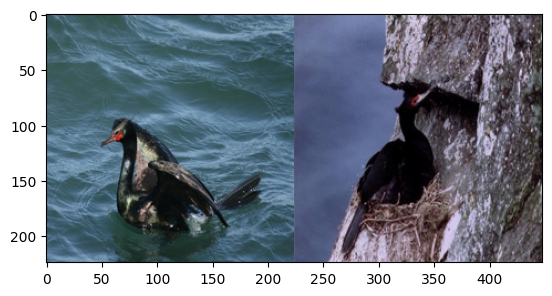

true label: 025.Pelagic_Cormorant  | predicted label: 024.Red_faced_Cormorant [24, 25, 23, 25, 25, 25, 24, 24, 25, 25]


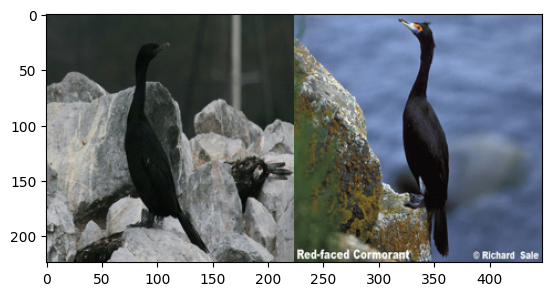

true label: 025.Pelagic_Cormorant  | predicted label: 044.Frigatebird [44, 24, 25, 44, 25, 44, 44, 44, 25, 90]


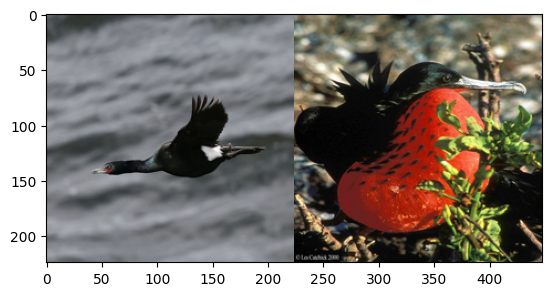

true label: 026.Bronzed_Cowbird  | predicted label: 027.Shiny_Cowbird [27, 70, 4, 11, 27, 4, 4, 4, 4, 9]


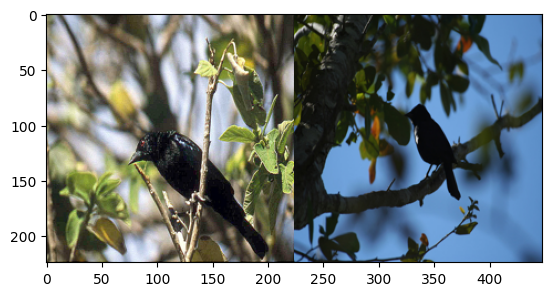

true label: 026.Bronzed_Cowbird  | predicted label: 009.Brewer_Blackbird [9, 27, 29, 30, 27, 29, 30, 30, 27, 30]


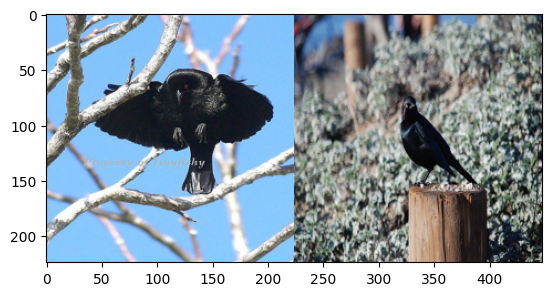

true label: 026.Bronzed_Cowbird  | predicted label: 009.Brewer_Blackbird [9, 11, 11, 11, 29, 30, 30, 27, 30, 11]


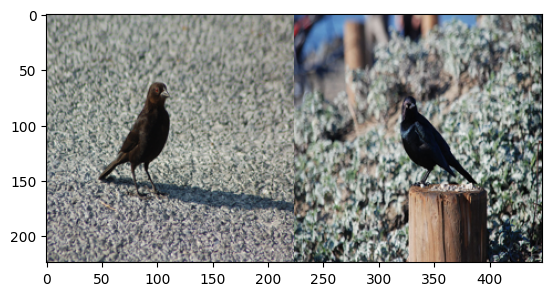

true label: 027.Shiny_Cowbird  | predicted label: 029.American_Crow [29, 27, 27, 49, 29, 49, 9, 29, 27, 27]


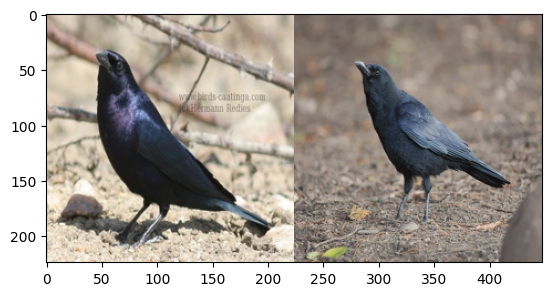

true label: 027.Shiny_Cowbird  | predicted label: 049.Boat_tailed_Grackle [49, 27, 27, 27, 27, 27, 27, 27, 27, 27]


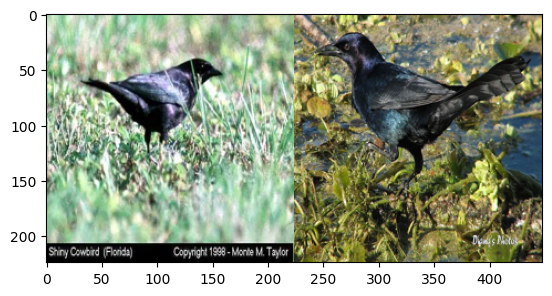

true label: 027.Shiny_Cowbird  | predicted label: 009.Brewer_Blackbird [9, 27, 11, 9, 11, 27, 9, 11, 9, 27]


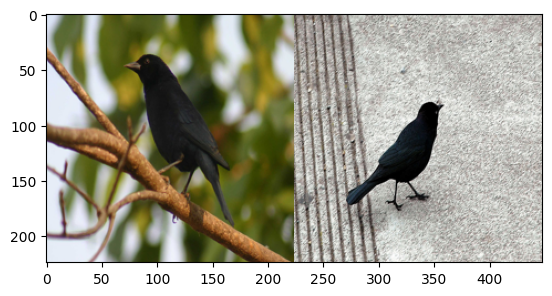

true label: 027.Shiny_Cowbird  | predicted label: 030.Fish_Crow [30, 30, 27, 29, 30, 29, 30, 30, 107, 27]


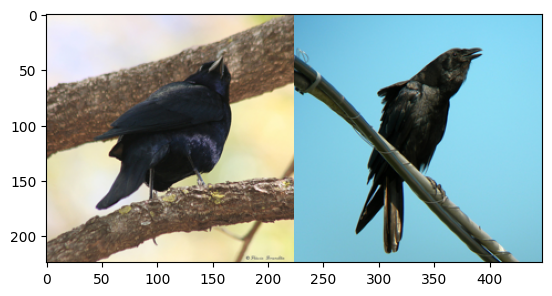

true label: 027.Shiny_Cowbird  | predicted label: 049.Boat_tailed_Grackle [49, 49, 49, 49, 49, 27, 27, 49, 27, 49]


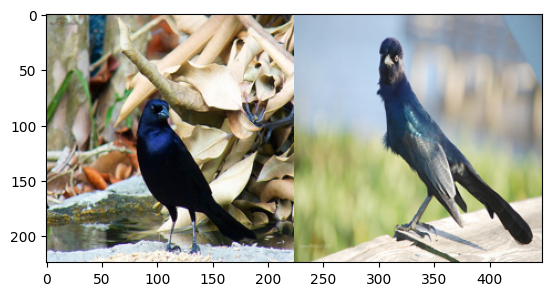

true label: 027.Shiny_Cowbird  | predicted label: 030.Fish_Crow [30, 29, 29, 107, 29, 30, 29, 107, 29, 30]


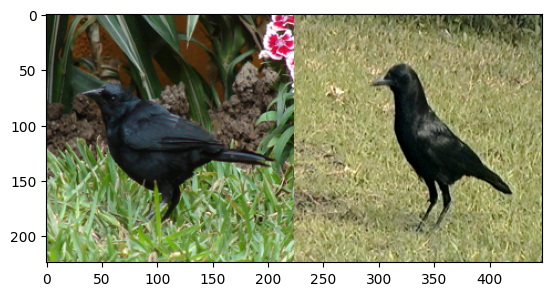

true label: 027.Shiny_Cowbird  | predicted label: 030.Fish_Crow [30, 49, 27, 27, 29, 27, 27, 27, 27, 27]


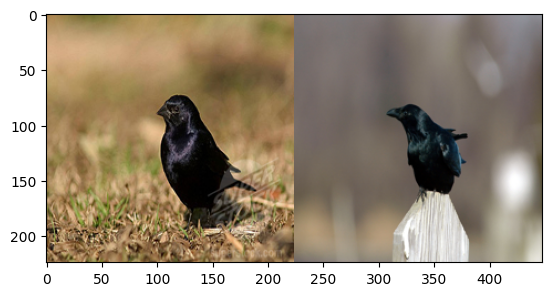

true label: 027.Shiny_Cowbird  | predicted label: 049.Boat_tailed_Grackle [49, 49, 49, 49, 9, 27, 9, 49, 49, 27]


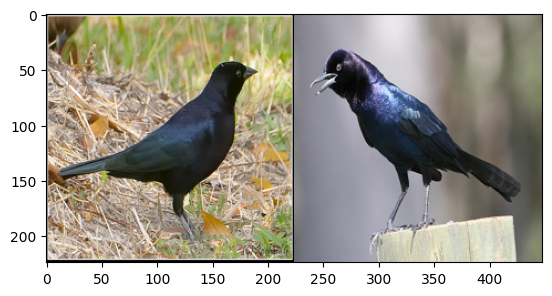

true label: 027.Shiny_Cowbird  | predicted label: 009.Brewer_Blackbird [9, 9, 9, 11, 27, 26, 9, 30, 9, 26]


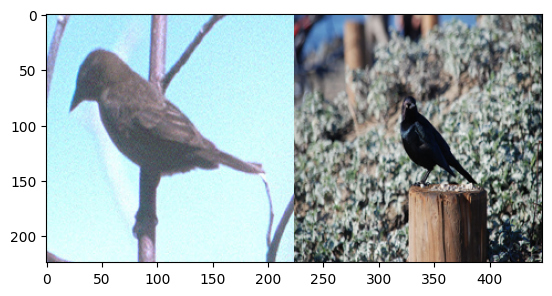

true label: 027.Shiny_Cowbird  | predicted label: 011.Rusty_Blackbird [11, 199, 11, 11, 11, 11, 199, 26, 30, 49]


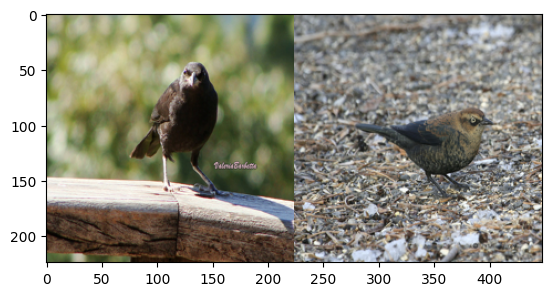

true label: 028.Brown_Creeper  | predicted label: 189.Red_bellied_Woodpecker [189, 110, 110, 28, 110, 110, 110, 190, 194, 194]


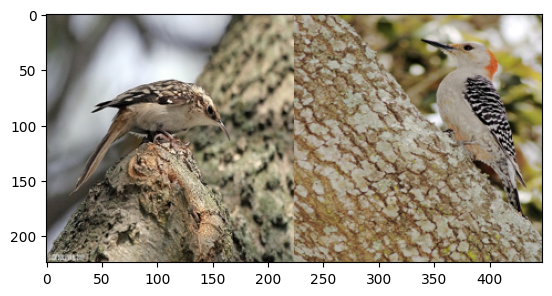

true label: 028.Brown_Creeper  | predicted label: 190.Red_cockaded_Woodpecker [190, 190, 28, 28, 28, 28, 28, 28, 28, 28]


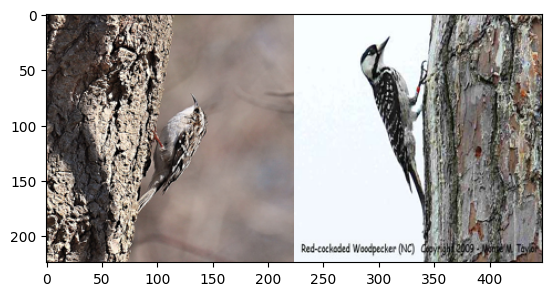

true label: 029.American_Crow  | predicted label: 030.Fish_Crow [30, 29, 29, 29, 30, 29, 30, 29, 30, 107]


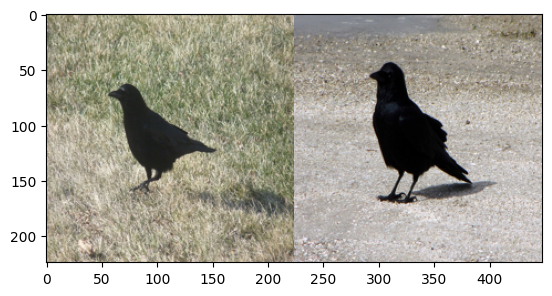

true label: 029.American_Crow  | predicted label: 030.Fish_Crow [30, 30, 49, 107, 29, 49, 107, 107, 29, 29]


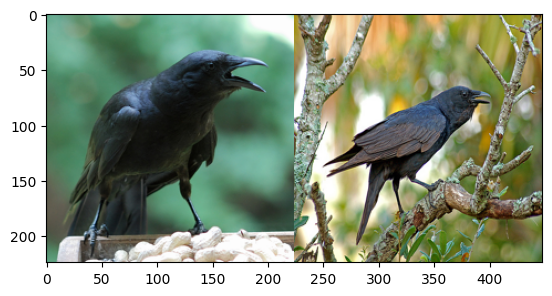

true label: 029.American_Crow  | predicted label: 107.Common_Raven [107, 29, 29, 107, 30, 107, 107, 30, 29, 107]


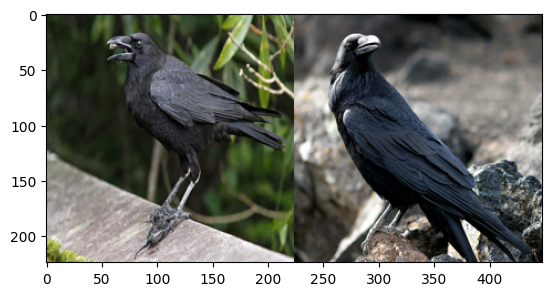

true label: 029.American_Crow  | predicted label: 027.Shiny_Cowbird [27, 27, 30, 29, 30, 30, 27, 4, 29, 30]


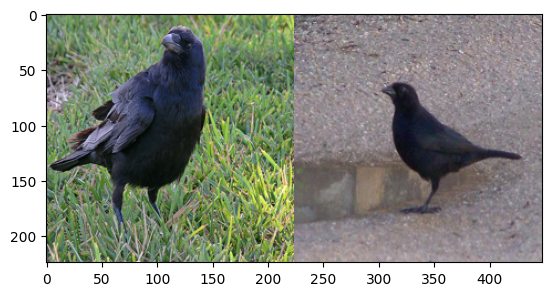

true label: 029.American_Crow  | predicted label: 030.Fish_Crow [30, 30, 29, 107, 29, 30, 30, 29, 29, 107]


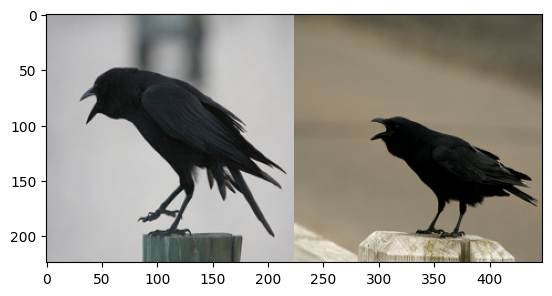

true label: 029.American_Crow  | predicted label: 030.Fish_Crow [30, 107, 108, 29, 29, 107, 29, 29, 107, 107]


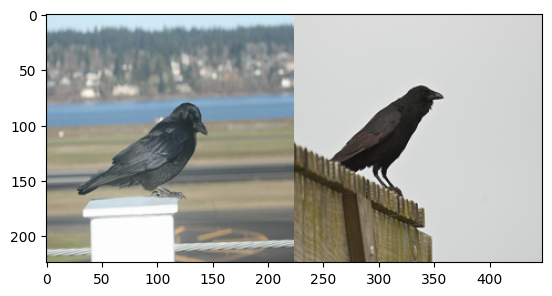

true label: 029.American_Crow  | predicted label: 030.Fish_Crow [30, 29, 107, 107, 29, 108, 29, 29, 30, 107]


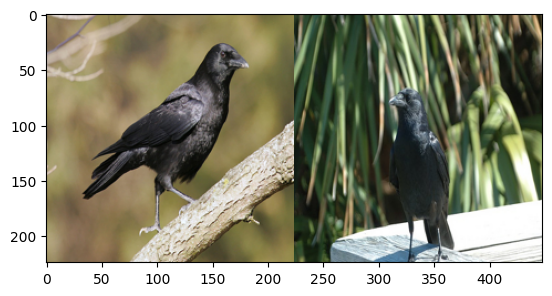

true label: 029.American_Crow  | predicted label: 030.Fish_Crow [30, 107, 30, 29, 29, 29, 30, 107, 29, 29]


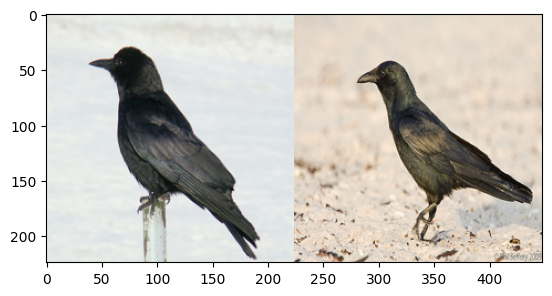

true label: 030.Fish_Crow  | predicted label: 029.American_Crow [29, 30, 30, 30, 29, 29, 29, 29, 30, 30]


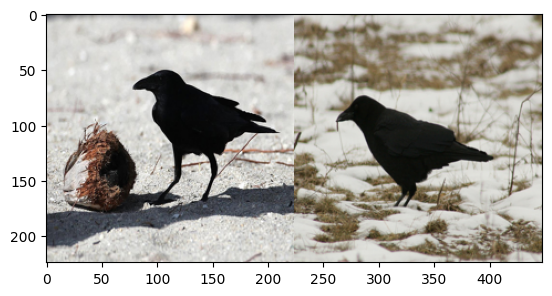

true label: 030.Fish_Crow  | predicted label: 029.American_Crow [29, 30, 30, 30, 30, 30, 107, 30, 29, 30]


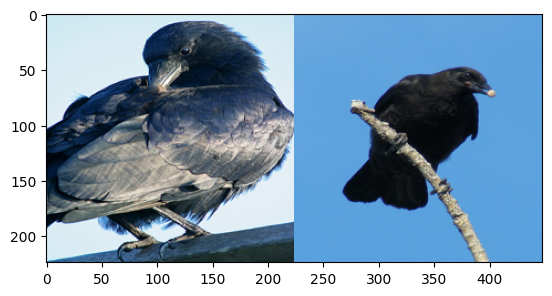

true label: 030.Fish_Crow  | predicted label: 013.Bobolink [13, 13, 13, 40, 108, 13, 40, 107, 27, 78]


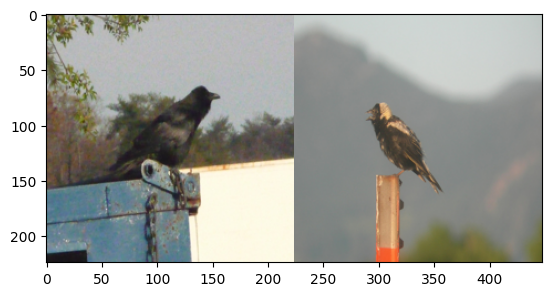

true label: 030.Fish_Crow  | predicted label: 029.American_Crow [29, 30, 29, 29, 29, 30, 29, 29, 29, 30]


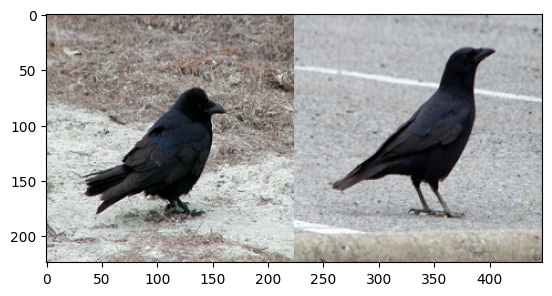

true label: 030.Fish_Crow  | predicted label: 009.Brewer_Blackbird [9, 108, 30, 108, 108, 107, 44, 107, 107, 107]


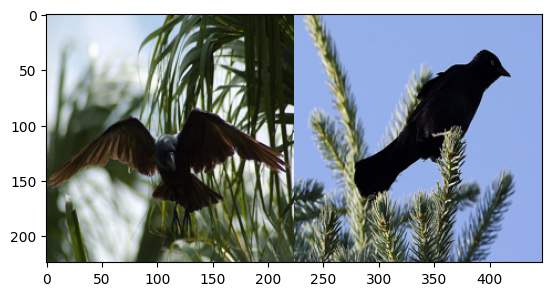

true label: 030.Fish_Crow  | predicted label: 029.American_Crow [29, 107, 107, 29, 29, 29, 29, 29, 107, 107]


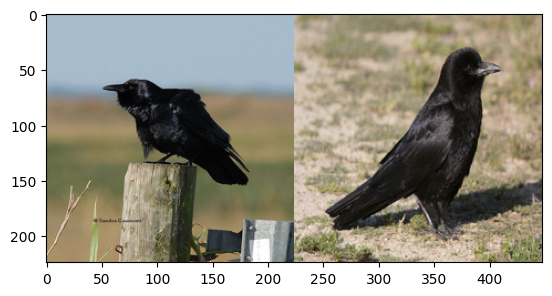

true label: 030.Fish_Crow  | predicted label: 107.Common_Raven [107, 29, 107, 29, 30, 30, 107, 29, 30, 30]


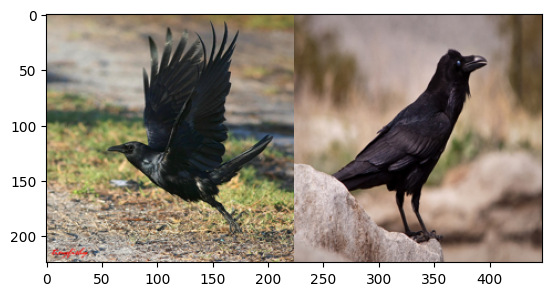

true label: 030.Fish_Crow  | predicted label: 027.Shiny_Cowbird [27, 30, 30, 30, 30, 29, 30, 29, 29, 29]


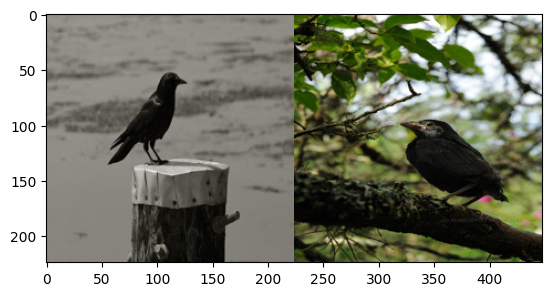

true label: 031.Black_billed_Cuckoo  | predicted label: 033.Yellow_billed_Cuckoo [33, 154, 33, 33, 33, 155, 33, 33, 33, 33]


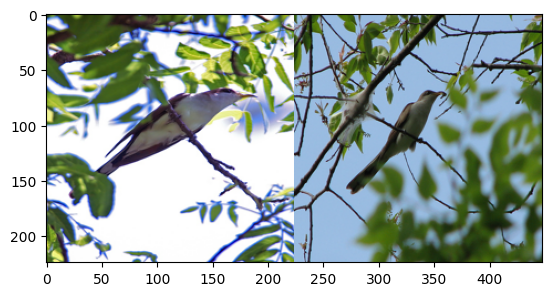

true label: 031.Black_billed_Cuckoo  | predicted label: 033.Yellow_billed_Cuckoo [33, 33, 33, 33, 33, 33, 33, 31, 33, 33]


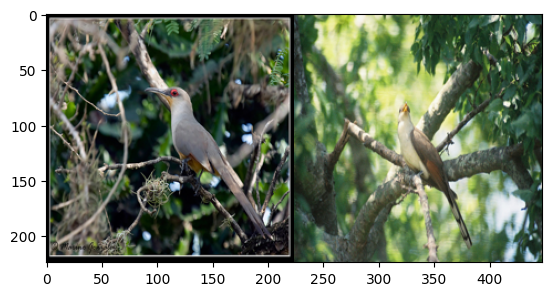

true label: 031.Black_billed_Cuckoo  | predicted label: 032.Mangrove_Cuckoo [32, 32, 20, 20, 32, 32, 32, 20, 20, 33]


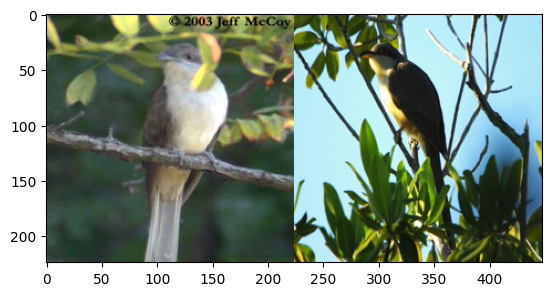

true label: 032.Mangrove_Cuckoo  | predicted label: 033.Yellow_billed_Cuckoo [33, 33, 33, 33, 33, 33, 33, 31, 33, 33]


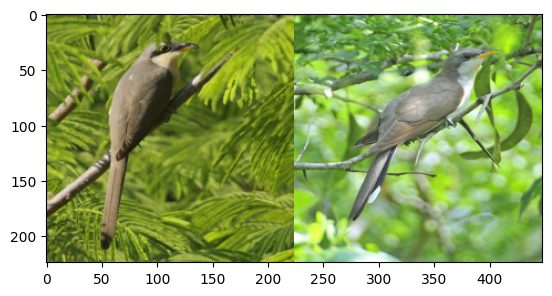

true label: 032.Mangrove_Cuckoo  | predicted label: 195.Carolina_Wren [195, 195, 31, 149, 195, 195, 31, 99, 197, 195]


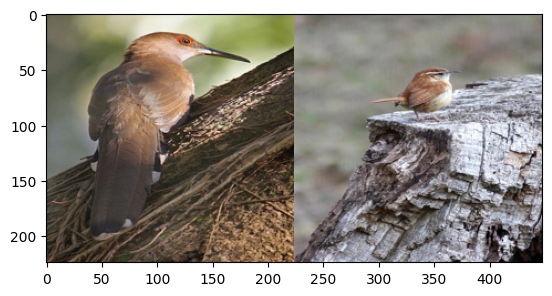

true label: 033.Yellow_billed_Cuckoo  | predicted label: 031.Black_billed_Cuckoo [31, 33, 31, 31, 31, 31, 31, 31, 33, 31]


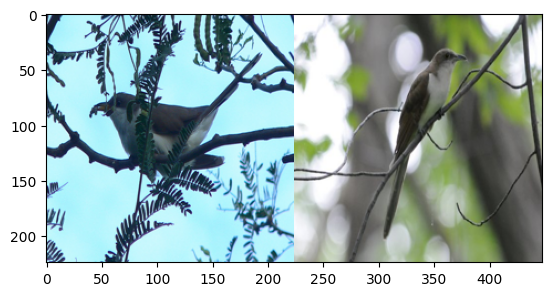

true label: 033.Yellow_billed_Cuckoo  | predicted label: 083.White_breasted_Kingfisher [83, 83, 83, 74, 83, 83, 83, 83, 83, 83]


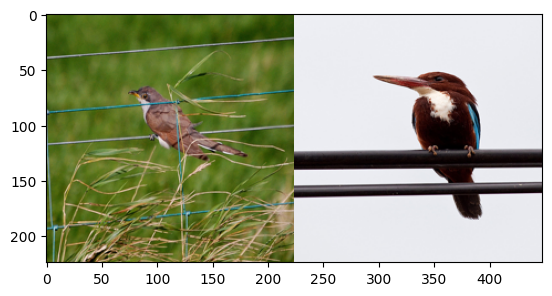

true label: 033.Yellow_billed_Cuckoo  | predicted label: 032.Mangrove_Cuckoo [32, 156, 156, 156, 156, 156, 32, 33, 33, 38]


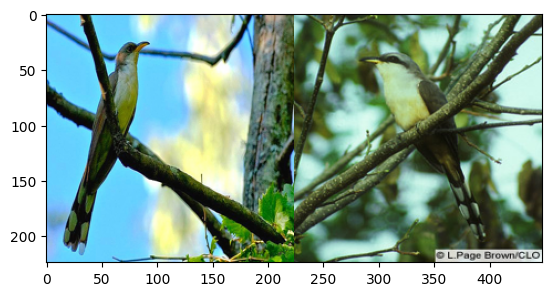

true label: 033.Yellow_billed_Cuckoo  | predicted label: 155.Warbling_Vireo [155, 165, 33, 33, 154, 155, 31, 33, 31, 151]


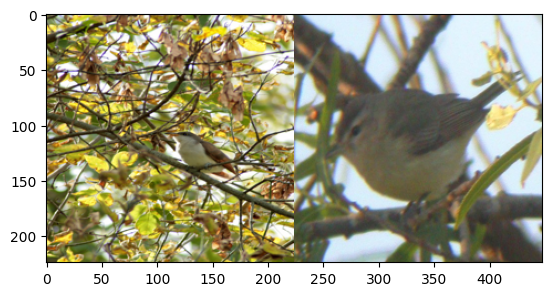

true label: 033.Yellow_billed_Cuckoo  | predicted label: 032.Mangrove_Cuckoo [32, 32, 32, 32, 32, 32, 33, 32, 4, 32]


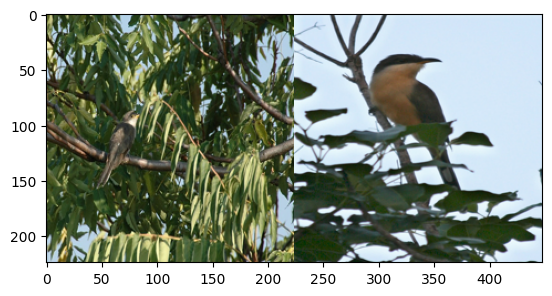

true label: 035.Purple_Finch  | predicted label: 056.Pine_Grosbeak [56, 35, 35, 56, 56, 35, 56, 56, 56, 35]


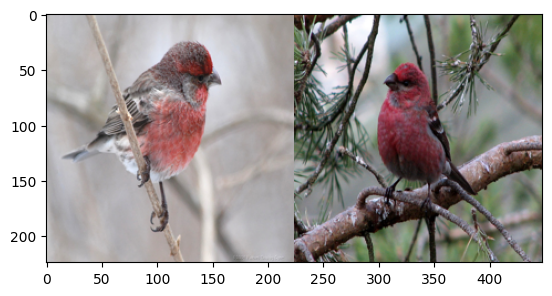

true label: 036.Northern_Flicker  | predicted label: 126.Nelson_Sharp_tailed_Sparrow [126, 196, 133, 197, 199, 11, 22, 11, 196, 196]


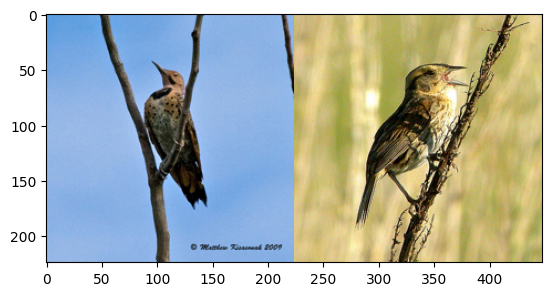

true label: 036.Northern_Flicker  | predicted label: 034.Gray_crowned_Rosy_Finch [34, 92, 11, 36, 194, 92, 11, 34, 92, 194]


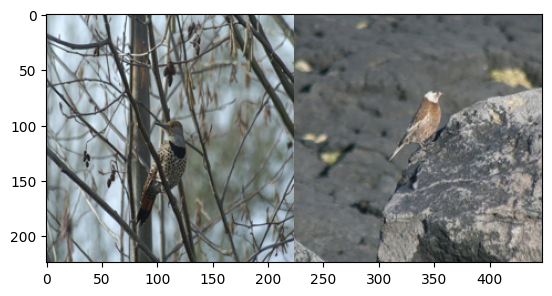

true label: 037.Acadian_Flycatcher  | predicted label: 039.Least_Flycatcher [39, 37, 39, 37, 39, 39, 37, 37, 39, 37]


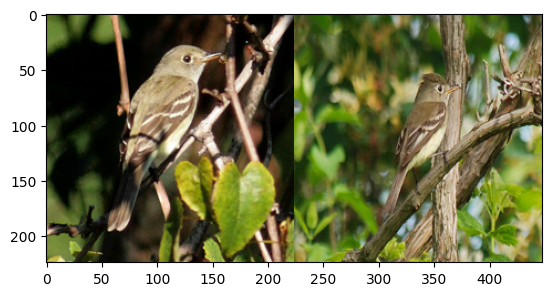

true label: 037.Acadian_Flycatcher  | predicted label: 102.Western_Wood_Pewee [102, 102, 37, 39, 39, 102, 102, 39, 37, 102]


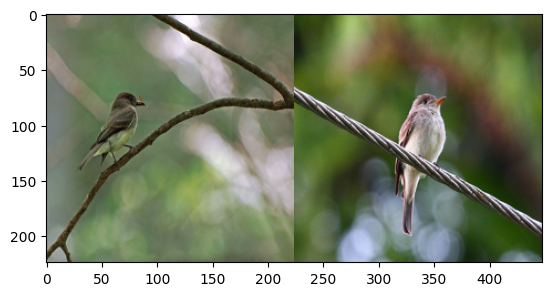

true label: 037.Acadian_Flycatcher  | predicted label: 103.Sayornis [103, 39, 102, 103, 39, 103, 102, 39, 37, 103]


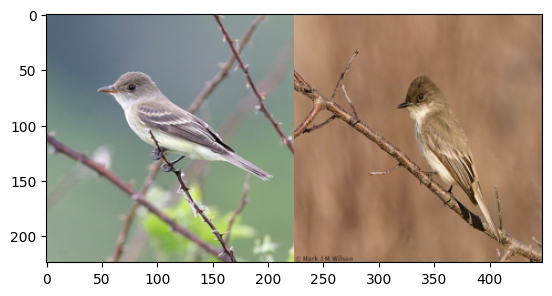

true label: 037.Acadian_Flycatcher  | predicted label: 179.Tennessee_Warbler [179, 179, 179, 178, 37, 153, 178, 102, 182, 157]


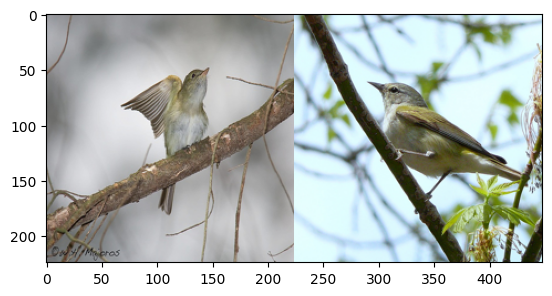

In [22]:
cnt  = 0
for path in sorted_paths:
    if cnt>100:
        break
    class_name = path.split('/')[-2]
    test_class_label = class_dict[class_name]
    img = PIL.Image.open(path)
    if len(img.getbands()) == 1:
        img = img.convert("RGB")
    transformed_img = test_transform(img)
    embedding = model(torch.unsqueeze(transformed_img,dim=0).to(device))
    _, indices = index.search(embedding.reshape(1,-1).detach().cpu().numpy().astype(np.float32), 10)
    pred_class = train_labels[indices[0][0]]
    if pred_class.detach().cpu().numpy().item() != test_class_label:
        all_labels = [train_labels[i].detach().cpu().numpy().item()+1 for i in indices[0]]
        print('true label:',class_name,' | predicted label:',rev_class_dict[pred_class.detach().cpu().numpy().item()],all_labels)
        predicted_img = PIL.Image.open(X_train[indices[0][0]])
        if len(predicted_img.getbands()) == 1:
            predicted_img = predicted_img.convert("RGB")
        plt.imshow(np.hstack([img.resize((224,224)),predicted_img.resize((224,224))]))
        plt.show()
        cnt+=1

## generate embeddings for entire dataset for fiftyone visualization 

In [127]:
sorted_test_paths = sorted(X_test, key=extract_category)
sorted_train_paths = sorted(X_train, key=extract_category)

In [104]:
train_embeddings = []
train_paths = []
train_labels = []
for path in sorted_train_paths:
    class_name = path.split('/')[-2]
    test_class_label = class_dict[class_name]
    img = PIL.Image.open(path)
    if len(img.getbands()) == 1:
        img = img.convert("RGB")
    transformed_img = test_transform(img)
    embedding = model(torch.unsqueeze(transformed_img,dim=0).to(device))
    train_embeddings.append(embedding.detach().cpu().numpy()[0])
    train_paths.append([path])
    train_labels.append([0])
    if test_class_label != 0:
        break

In [105]:
test_embeddings = []
test_paths = []
test_labels = []
for path in sorted_test_paths:
    class_name = path.split('/')[-2]
    test_class_label = class_dict[class_name]
    img = PIL.Image.open(path)
    if len(img.getbands()) == 1:
        img = img.convert("RGB")
    transformed_img = test_transform(img)
    embedding = model(torch.unsqueeze(transformed_img,dim=0).to(device))
    test_embeddings.append(embedding.detach().cpu().numpy()[0])
    test_paths.append([path])
    test_labels.append([1])
    if test_class_label != 0:
        break

In [107]:
all_embeddings = np.vstack([train_embeddings, test_embeddings])

In [21]:
with open('fiftyone_filepaths.txt','r') as f:
    filepaths = f.readlines()

In [22]:
filepaths = [i.replace('\n','') for i in filepaths]

In [23]:
len(filepaths)

11788

In [24]:
embeddings = []
for path in filepaths:
    img = PIL.Image.open(path.replace('/home/pranav/embedding_classification/',''))
    if len(img.getbands()) == 1:
        img = img.convert("RGB")
    transformed_img = test_transform(img)
    embedding = model(torch.unsqueeze(transformed_img,dim=0).to(device))
    embeddings.append(embedding.detach().cpu().numpy()[0])

In [25]:
np.array(embeddings).shape

(11788, 128)

In [26]:
np.save('fiftyone_embeddings', np.array(embeddings)) 